To ensure all sections of this notebook function correctly, please execute:
1. Setup notebook
2. Setup data

I've tried to keep functions fairly generalised so they can be used for different use cases!

# Setup notebook
Code to correctly setup the settings for the notebook.

In [1]:
import os, sys
for root, dirs, files in os.walk(os.getcwd()):
    print(root)
    if "pi0-analysis" in root.split("/"):
        pypath = root.split("pi0-analysis")[0] + "/pi0-analysis/analysis"
        print(pypath)
        break

sys.path.insert(0, pypath)

from python.analysis.NotebookUtils import init_notebook
%init_notebook

/home/pemb6649/pi0-analysis/analysis/summer-placement
/home/pemb6649//pi0-analysis/analysis
/home/pemb6649//pi0-analysis/analysis
env: PYTHONPATH=/home/pemb6649//pi0-analysis/analysis


In [2]:
from rich import print

# Note these are examples of the mose useful/common libraries to rely on
from python.analysis import (
    Master, # Core library for Ntuple file manipulation
    BeamParticleSelection, # Defined selections for the beam particle.
    PFOSelection, # Defined selections for (Particle Flow Objects) PFOs
    Plots, # Plotting functions
    vector, # doing vector operations using Awkward.
    Tags, # Creating event tags
    cross_section, # Helper functions specifically for the cross section analysis code
    EventSelection, # Helper functions for event selection,
    SelectionTools # Helper functions for event selection
)# Fo


from apps.cex_analysis_input import BeamPionSelection
from python.analysis import Utils

cross_section.PlotStyler.SetPlotStyle(dpi = 100, dark = True) # set the plot style to use (aesthetics)

In [3]:
# required libraries for the ML approach

import awkward as ak # library for manipulating vectors faster than numpy
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, RocCurveDisplay
from sklearn.preprocessing import LabelEncoder
from sklearn import tree
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import plotly.express as px

# models

from xgboost import XGBClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
import xgboost as xgb

# other

import pickle
from datetime import datetime
import dill

# custom functions

from utils import *

# Setup data

In [4]:
mc_files = ["/data/dune/common/PDSPAnalyzer_Ntuples/PDSPProd4a_MC_2GeV_sce_datadriven_ntuple_v09_81_00d01_set0.root",
            "/data/dune/common/PDSPAnalyzer_Ntuples/PDSPProd4a_MC_2GeV_sce_datadriven_ntuple_v09_81_00d01_set1.root",
            "/data/dune/common/PDSPAnalyzer_Ntuples/PDSPProd4a_MC_2GeV_sce_datadriven_ntuple_v09_81_00d01_set2.root",
            "/data/dune/common/PDSPAnalyzer_Ntuples/PDSPProd4a_MC_2GeV_sce_datadriven_ntuple_v09_81_00d01_set3.root",
            "/data/dune/common/PDSPAnalyzer_Ntuples/PDSPProd4a_MC_2GeV_reco1_sce_datadriven_v1_ntuple_v09_41_00_03.root",
]

In [5]:
# small dataset (10,000 events)
small_data_path = "/home/pemb6649/pi0-analysis/analysis/summer-placement/extracted-data/data_10000.pkl"
small_data = load_file(small_data_path)

# full dataset (665440 events)
full_data_path = "/home/pemb6649/pi0-analysis/analysis/summer-placement/extracted-data/data_full.pkl"
full_data = load_file(full_data_path)

In [6]:
full_split_data = load_file("/home/pemb6649/pi0-analysis/analysis/summer-placement/extracted-data/data_full_split.pkl")
full_x_train = full_split_data["x_train"]
full_x_test = full_split_data["x_test"]
full_y_train = full_split_data["y_train"]
full_y_test = full_split_data["y_test"]

full_split_data_binary = load_file("/home/pemb6649/pi0-analysis/analysis/summer-placement/extracted-data/data_full_binary_split.pkl")
full_x_train_binary = full_split_data_binary["x_train"]
full_x_test_binary = full_split_data_binary["x_test"]
full_y_train_binary = full_split_data_binary["y_train"]
full_y_test_binary = full_split_data_binary["y_test"]

full_split_data_binary_balanced = load_file("/home/pemb6649/pi0-analysis/analysis/summer-placement/extracted-data/data_full_binary_balanced_split.pkl")
full_x_train_binary_balanced = full_split_data_binary_balanced["x_train"]
full_x_test_binary_balanced = full_split_data_binary_balanced["x_test"]
full_y_train_binary_balanced = full_split_data_binary_balanced["y_train"]
full_y_test_binary_balanced = full_split_data_binary_balanced["y_test"]

small_split_data = load_file("/home/pemb6649/pi0-analysis/analysis/summer-placement/extracted-data/data_10000_split.pkl")
small_x_train = small_split_data["x_train"]
small_x_test = small_split_data["x_test"]
small_y_train = small_split_data["y_train"]
small_y_test = small_split_data["y_test"]

small_split_data_binary = load_file("/home/pemb6649/pi0-analysis/analysis/summer-placement/extracted-data/data_10000_binary_split.pkl")
small_x_train_binary = small_split_data_binary["x_train"]
small_x_test_binary = small_split_data_binary["x_test"]
small_y_train_binary = small_split_data_binary["y_train"]
small_y_test_binary = small_split_data_binary["y_test"]

small_split_data_binary_balanced = load_file("/home/pemb6649/pi0-analysis/analysis/summer-placement/extracted-data/data_10000_binary_balanced_split.pkl")
small_x_train_binary_balanced = small_split_data_binary_balanced["x_train"]
small_x_test_binary_balanced = small_split_data_binary_balanced["x_test"]
small_y_train_binary_balanced = small_split_data_binary_balanced["y_train"]
small_y_test_binary_balanced = small_split_data_binary_balanced["y_test"]

In [7]:
le = LabelEncoder()
le.fit_transform(full_y_train)
pion_class_label = "$\\pi^{\\pm}$"

# ML workflow
Preliminary showcase of a random forest classifer.

## Manual demo

In [ ]:
df = pd.DataFrame(small_data)
df.head()

,track_dEdX_mean,track_dEdX_median,track_dQdX_mean,track_dQdX_median,residual_range_median,residual_range_mean,track_chi2/ndof_proton,track_chi2/ndof_pion,track_chi2/ndof_muon,track_length,...,track_end_pos_y,track_end_pos_z,particle,hit_density,angle_to_beam,distance_from_beam,dEdX/dQdX,dEdX_per_length,angle_to_vertical,dEdX_end_pos
0,2.697233,1.803803,70.462522,55.478149,46.573074,47.342638,166.324808,17.563040,14.788307,94.991625,...,361.389008,205.434784,$\pi^{\pm}$:2nd,1.484341,-88.575353,1.429546,0.038279,0.028394,0.618298,1.723113
1,46.238247,6.665603,246.978881,157.095474,13.389076,13.027541,1.984713,35.581015,36.443756,23.881886,...,386.267365,161.125290,$p$,2.009892,-113.253265,1.342037,0.187215,1.936122,0.922579,215.680717
2,0.957016,0.802299,27.266159,22.506063,1.759761,2.434822,285.341374,44.145326,30.075351,8.760562,...,357.551147,210.375671,$\gamma$,1.483923,-50.220107,90.662323,0.035099,0.109241,0.265866,1.563557
3,4.094241,3.694600,109.754062,103.347519,2.841419,3.530263,132.863472,4.566661,2.264422,7.197488,...,394.379395,132.980927,$\pi^{\pm}$:2nd,2.222998,63.678218,2.669990,0.037304,0.568843,-0.743320,3.682003
4,4.123076,4.354799,104.957987,115.039940,3.028353,3.099426,120.420781,12.983068,10.691429,6.141218,...,370.813873,218.085556,$\gamma$,1.628341,-81.012323,105.272475,0.039283,0.671378,0.710889,4.451405


In [ ]:
df = clean_df(df, verbose=True)  # remove rows with missing values
x_train, x_test, y_train, y_test = split_train_test(df, verbose=True, save=True, binary_classification=True, balance_data=True, data_path="/home/pemb6649/pi0-analysis/analysis/summer-placement/extracted-data/data_full_binary_balanced_split.pkl")

Removed 50349 rows with missing entries. 


/home/pemb6649/pi0-analysis/analysis/summer-placement/utils.py:254: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  y[i] = 0
/home/pemb6649/pi0-analysis/analysis/summer-placement/utils.py:252: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  y[i] = 1


Saved {'x_train':         track_dEdX_mean  track_dEdX_median  track_dQdX_mean  \
112597         3.809499           3.231687       101.118171   
137364         8.823561           3.381419       128.038998   
15777          2.790690           1.759008        69.606196   
122886         2.307713           1.454572        61.726517   
69012          1.249353           1.230660        37.975986   
...                 ...                ...              ...   
110268         7.983879           3.695215       128.722643   
119879         2.896762           2.950252        80.700566   
103694         1.906656           1.756698        57.212043   
131932         1.304711           1.236976        39.237400   
121958         1.577250           1.530309        46.548626   

        track_dQdX_median  residual_range_median  residual_range_mean  \
112597          92.953819               5.705419             4.695774   
137364          95.950363             122.327019           112.108038   
15777 

In [131]:
model = RandomForestClassifier(n_estimators=100, random_state=42, verbose=1, max_depth=15)
model.fit(x_train, y_train)
y_pred = model.predict(x_test).tolist()

[Parallel(n_jobs=1)]: Done  49 tasks      | elapsed:  1.2min
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:  2.5min finished
[Parallel(n_jobs=1)]: Done  49 tasks      | elapsed:    0.5s
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    1.0s finished


In [132]:
pred_df = pd.DataFrame({
    "predicted": y_pred,
    "true": y_test
})
pred_df.head(10)

,predicted,true
0,$p$,$\pi^{\pm}$
1,$p$,$p$
2,$\pi^{\pm}$,$\pi^{\pm}$
3,$p$,$p$
4,$\pi^{\pm}$,$\pi^{\pm}$:2nd
5,$p$,$p$
6,$\gamma$,$\gamma$
7,$p$,$\pi^{\pm}$
8,$\pi^{\pm}$,$\pi^{\pm}$
9,$p$,$p$


In [133]:
y_pred_train = model.predict(x_train).tolist()
pions = ["$\pi^{\pm}$"]
purity_y_pred, purity_uncertainty = purity(y_pred_train, y_train, pions, pions, return_uncertainty=True)
efficiency_y_pred, efficiency_uncertainty = efficiency(y_pred_train, y_train, pions, pions, return_uncertainty=True)

print(f"Charged pion purity: {100*purity_y_pred:.1f}% ± {100*purity_uncertainty:.1f}%")
print(f"Charged pion efficiency: {100*efficiency_y_pred:.1f}% ± {100*efficiency_uncertainty:.1f}%")

[Parallel(n_jobs=1)]: Done  49 tasks      | elapsed:    2.2s
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    4.4s finished


Charged pion purity: 75.3% ± 0.2%

Charged pion efficiency: 88.0% ± 0.1%

In [134]:
pions = ["$\pi^{\pm}$"]
purity_y_pred, purity_uncertainty = purity(y_pred, y_test, pions, pions, return_uncertainty=True)
efficiency_y_pred, efficiency_uncertainty = efficiency(y_pred, y_test, pions, pions, return_uncertainty=True)

print(f"Charged pion purity: {100*purity_y_pred:.1f}% ± {100*purity_uncertainty:.1f}%")
print(f"Charged pion efficiency: {100*efficiency_y_pred:.1f}% ± {100*efficiency_uncertainty:.1f}%")

Charged pion purity: 69.6% ± 0.4%

Charged pion efficiency: 80.1% ± 0.3%

## Master function demo (automated workflow)

Fitting model...
Model fitted.
           $\pi^{\pm}$     Test Data    Train Data
0       Test Particles          1165          4660
1               Purity  56.0% ± 2.8%  60.3% ± 1.5%
2           Efficiency  78.8% ± 2.7%  77.4% ± 1.4%
3  Purity x Efficiency  44.1% ± 5.5%  46.7% ± 2.9%


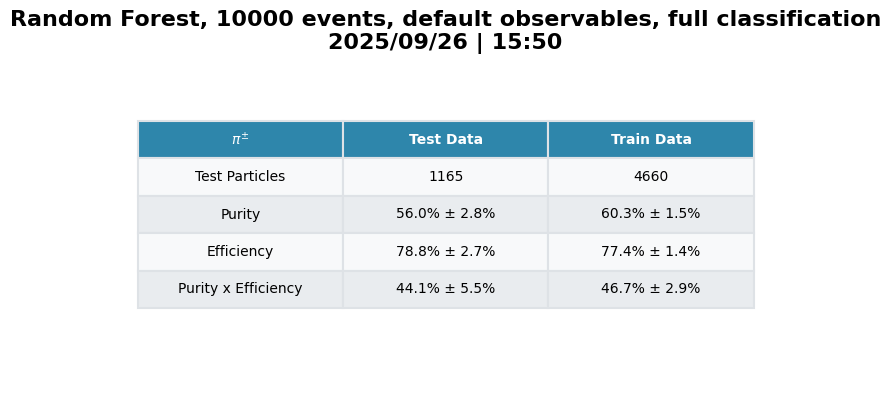

Cannot calculate standard deviation of feature importances.


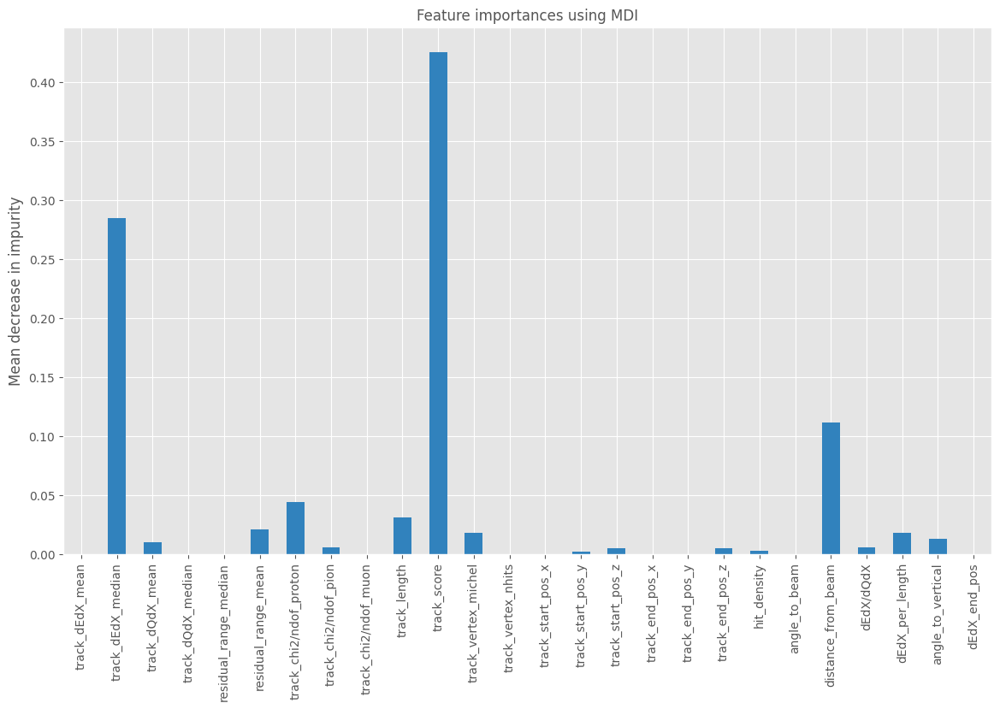

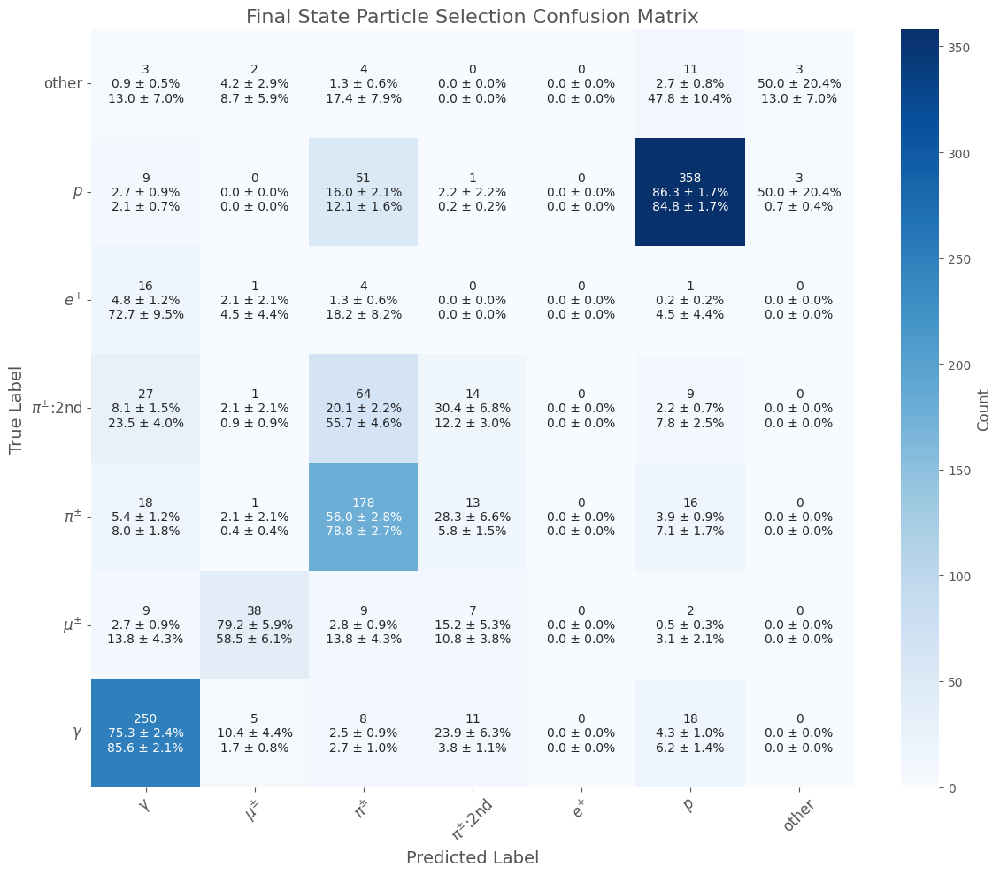

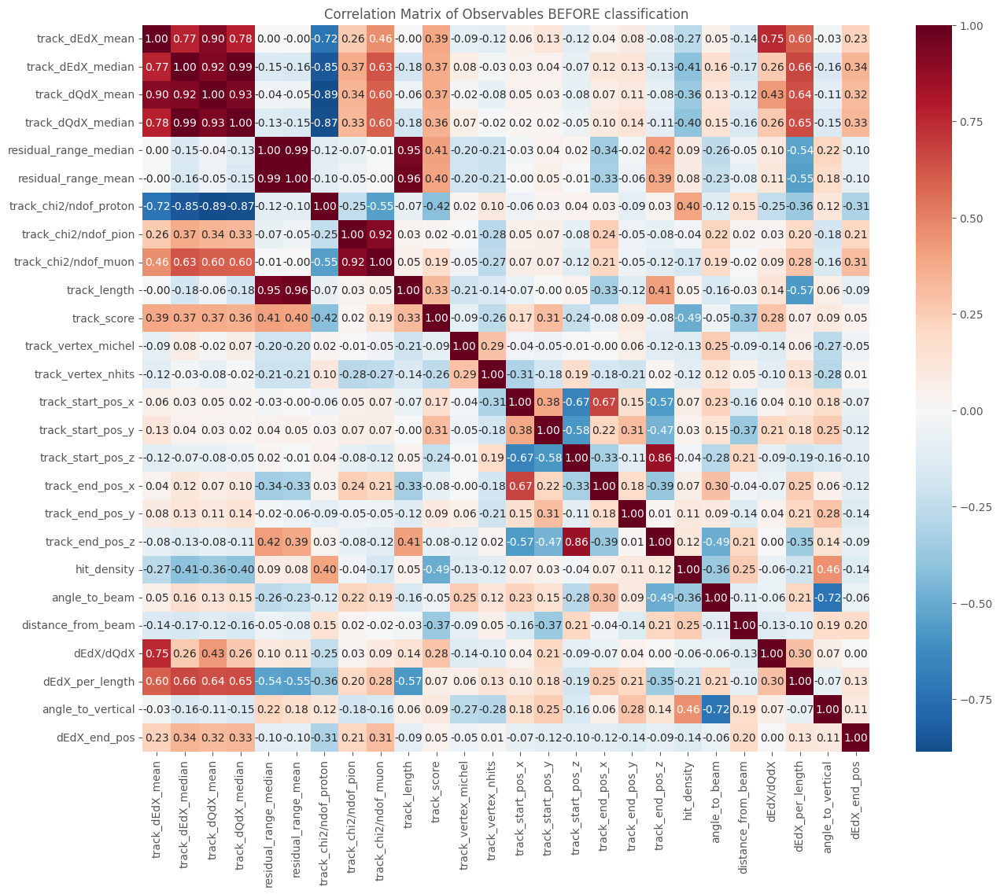

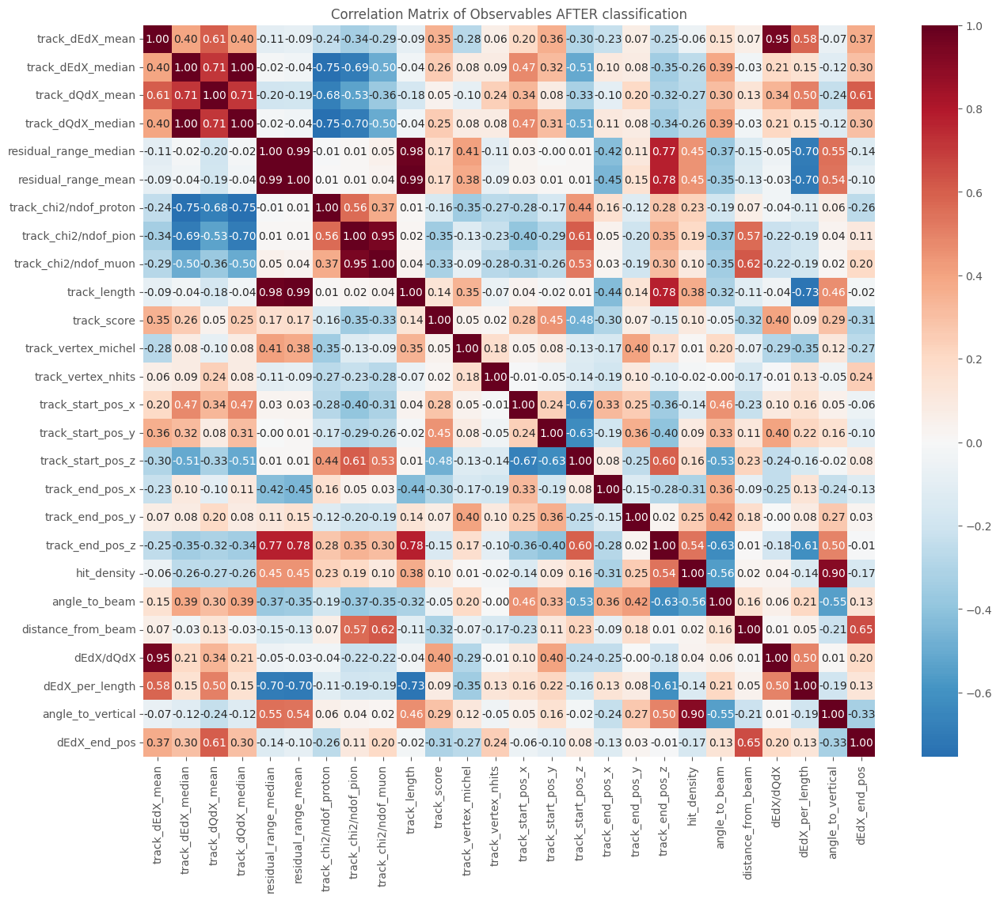

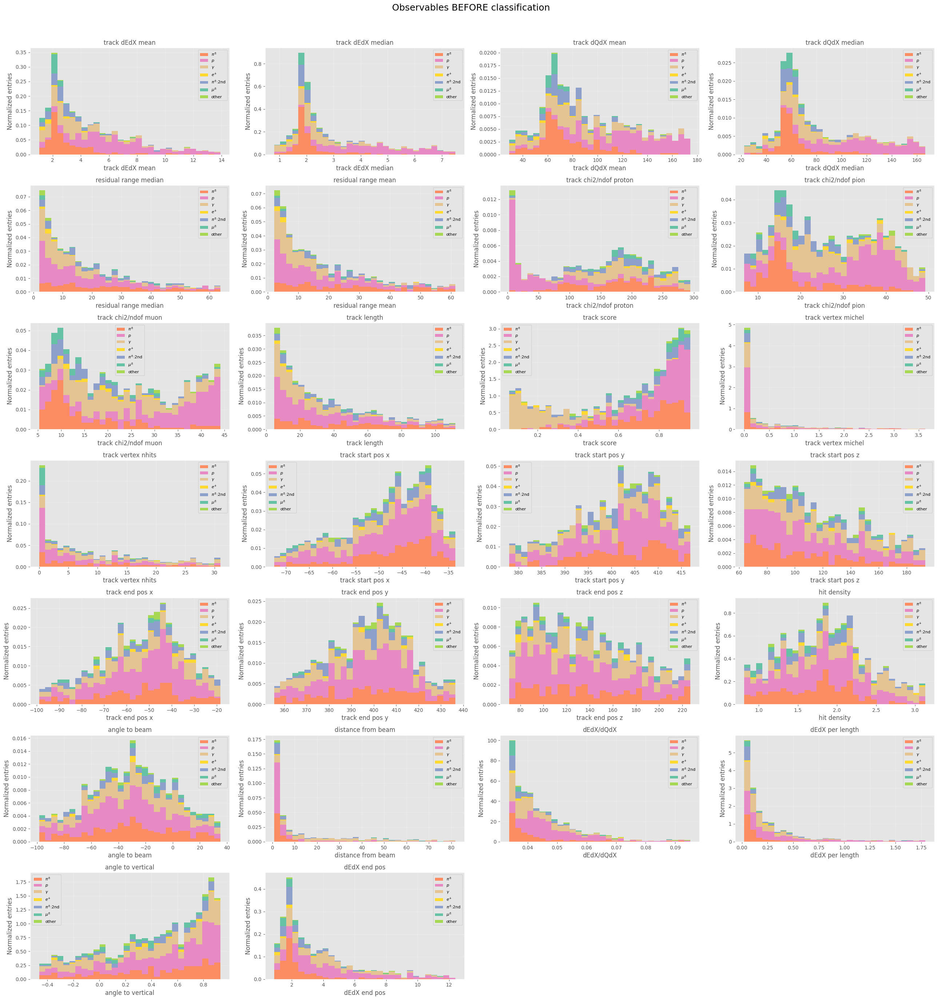

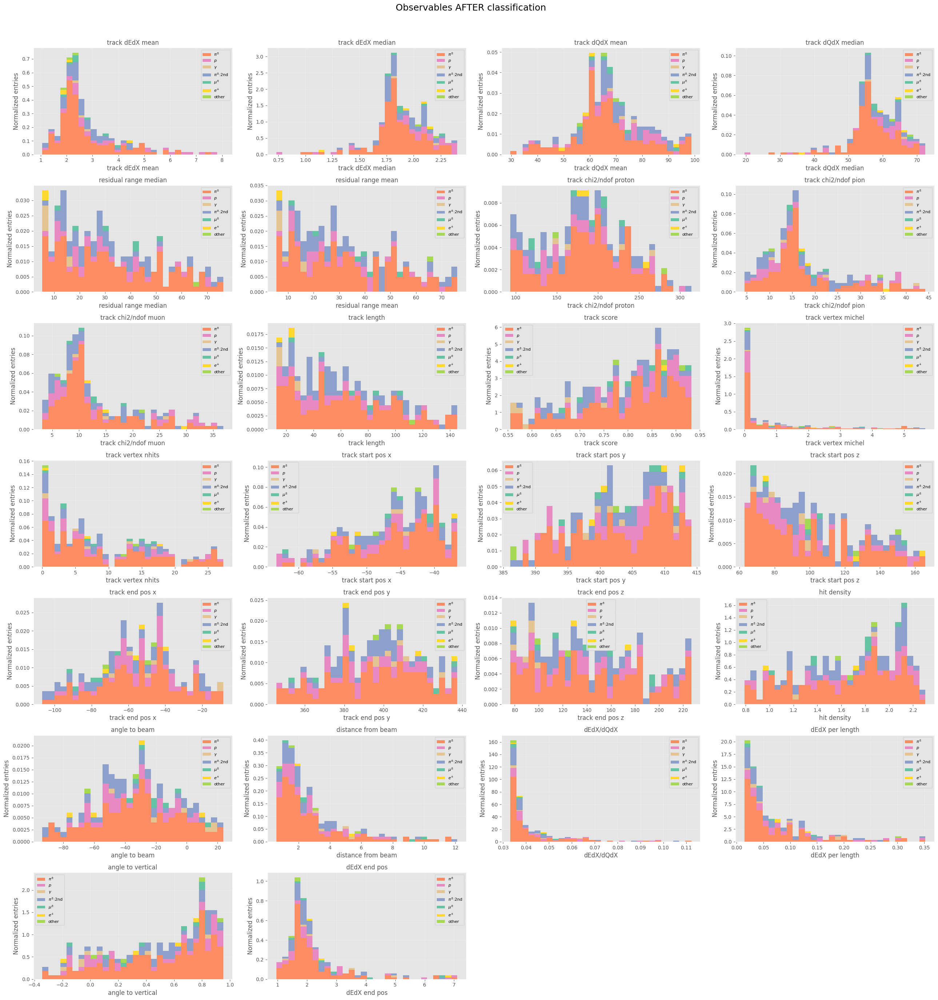

In [55]:
DT = DecisionTreeClassifier(max_depth=5, random_state=42, criterion="gini")
master_pion_selection(data=small_split_data, model=DT, save=False, plot=True, verbose=True, title="Random Forest, 10000 events, default observables");

# Playing with different models (experimental)
Investigating initial performance with a single decision tree, random forest, XGBoost, multi-layer perceptron classifer (netural network).

## Decision Tree

In [89]:
DT = DecisionTreeClassifier(max_depth=2, random_state=42)
master_pion_selection(data=small_split_data, model=DT, verbose=True, title="DT");

Fitting model...
Model fitted.
           $\pi^{\pm}$     Test Data    Train Data
0       Test Particles          1165          4660
1               Purity  44.6% ± 2.6%  48.1% ± 1.4%
2           Efficiency  74.8% ± 2.9%  74.5% ± 1.5%
3  Purity x Efficiency  33.3% ± 5.4%  35.8% ± 2.8%


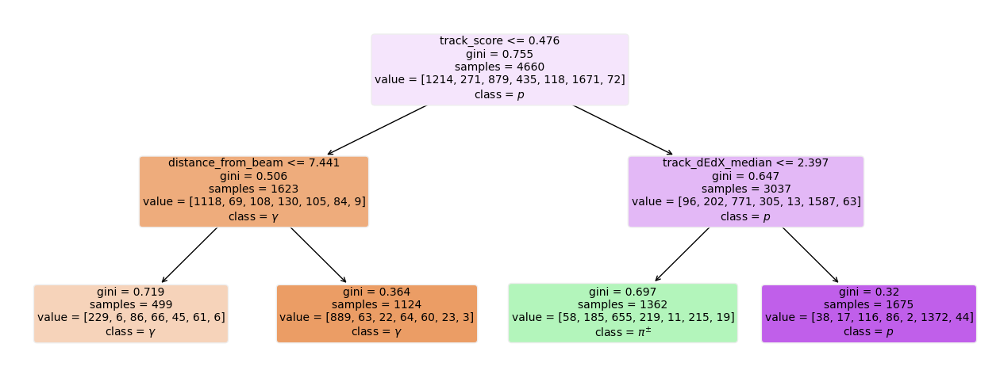

In [80]:
features = [k for k in small_data[0].keys() if k != "particle"]
class_names = [le.inverse_transform([cls])[0] for cls in DT.classes_]

output_dir = "/home/pemb6649/pi0-analysis/analysis/summer-placement/tree-visualisation"
os.makedirs(output_dir, exist_ok=True)

fig = plt.figure(figsize=(16, 6))
_ = tree.plot_tree(
    DT,
    feature_names=features,
    class_names=class_names,
    filled=True,
    fontsize=10,
    rounded=True
)
fig.savefig(os.path.join(output_dir, "decision_tree.png"))

In [92]:
DT = DecisionTreeClassifier(max_depth=5, random_state=42)
master_pion_selection(data=small_split_data_binary, model=DT, verbose=True, title="Decision Tree");

Fitting model...
Model fitted.
                     1     Test Data    Train Data
0       Test Particles          1165          4660
1               Purity  60.6% ± 3.0%  67.3% ± 1.5%
2           Efficiency  69.5% ± 3.1%  74.1% ± 1.5%
3  Purity x Efficiency  42.1% ± 6.1%  49.8% ± 3.0%


In [107]:
DT = DecisionTreeClassifier(max_depth=10, random_state=42)
master_pion_selection(data=full_split_data, model=DT, verbose=True, title="Decision Tree");

Fitting model...
Model fitted.
           $\pi^{\pm}$     Test Data    Train Data
0       Test Particles         73558        294232
1               Purity  63.4% ± 0.4%  64.4% ± 0.2%
2           Efficiency  75.3% ± 0.4%  77.1% ± 0.2%
3  Purity x Efficiency  47.7% ± 0.7%  49.7% ± 0.4%


## Random Forest

Fitting model...
Model fitted.
                     1     Test Data    Train Data
0       Test Particles          1165          4660
1               Purity  70.4% ± 3.5%  85.8% ± 1.3%
2           Efficiency  52.7% ± 3.3%  74.2% ± 1.5%
3  Purity x Efficiency  37.1% ± 6.8%  63.6% ± 2.7%


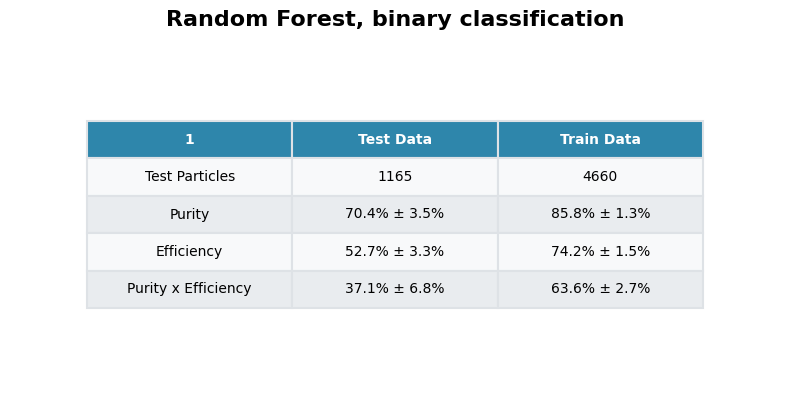

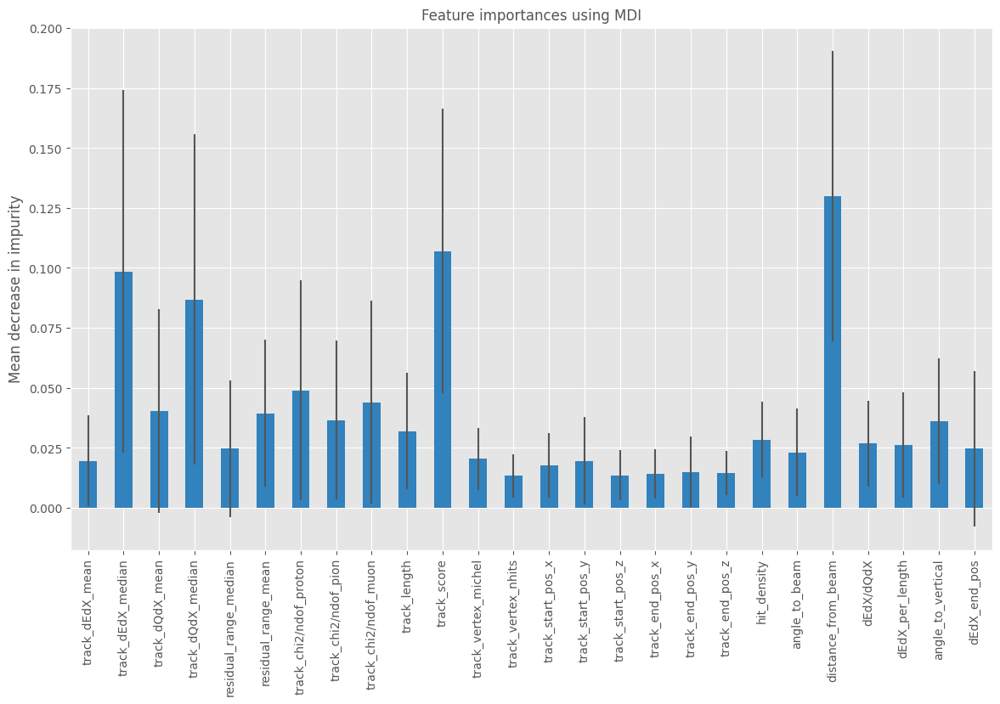

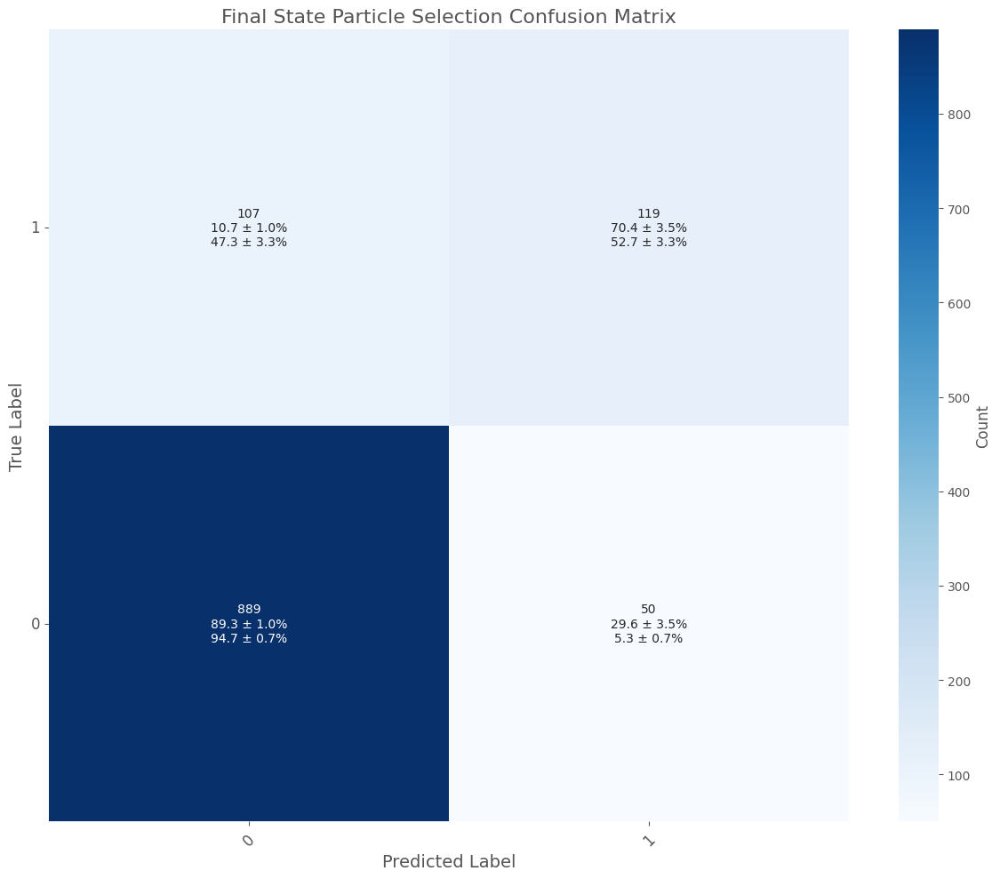

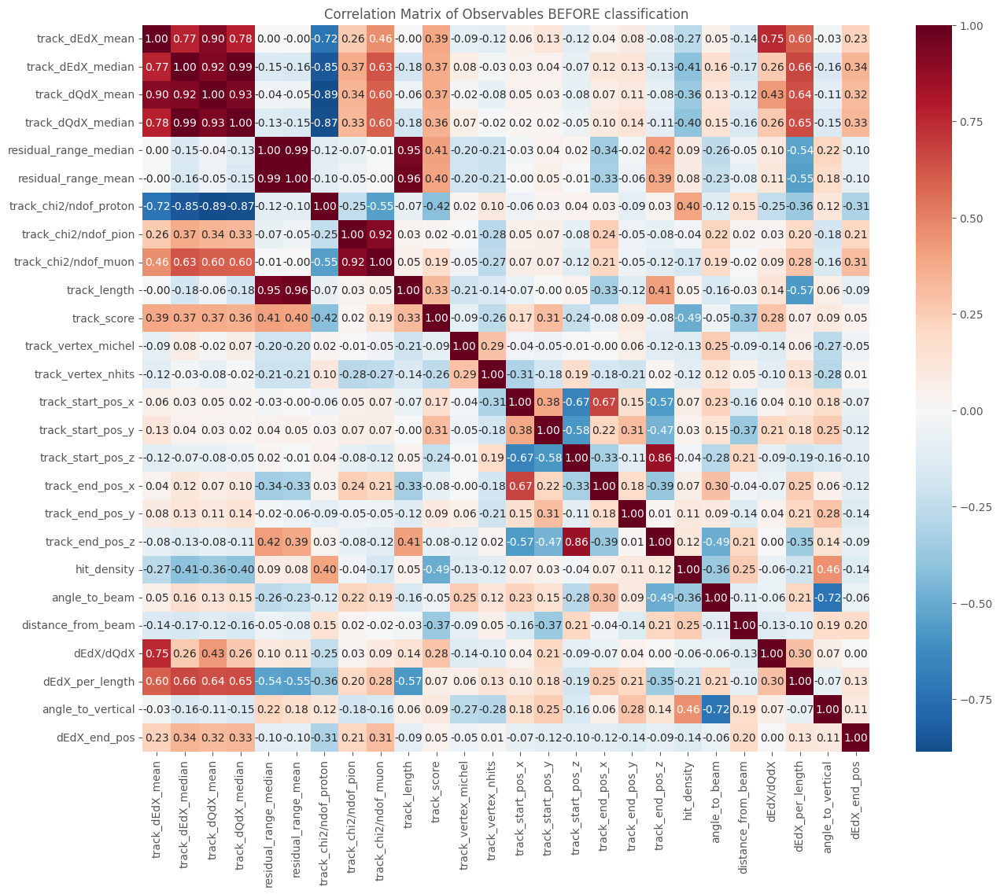

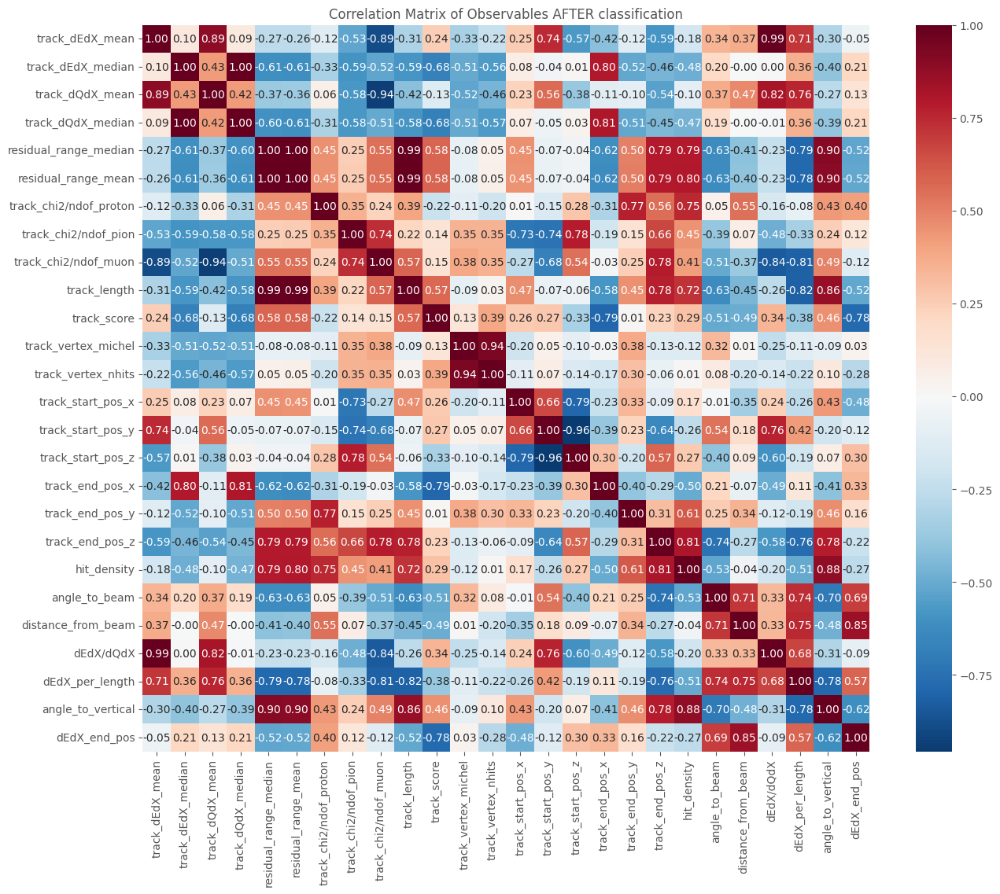

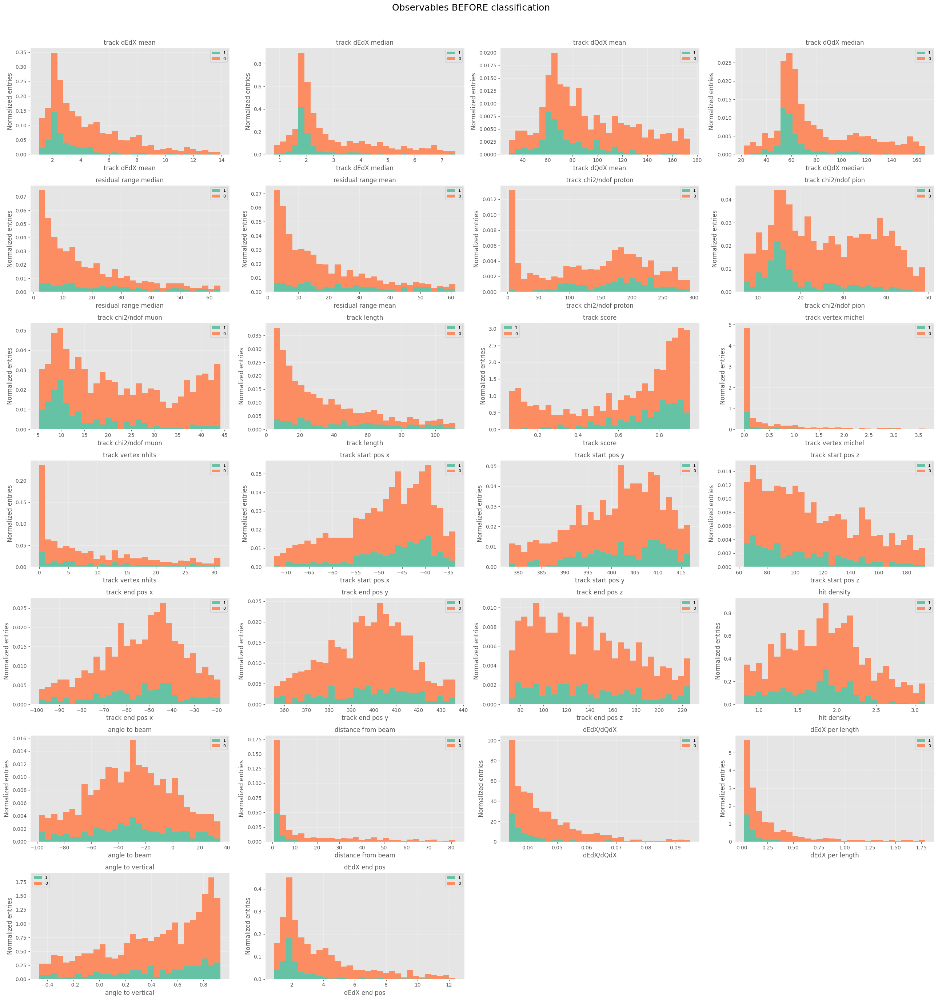

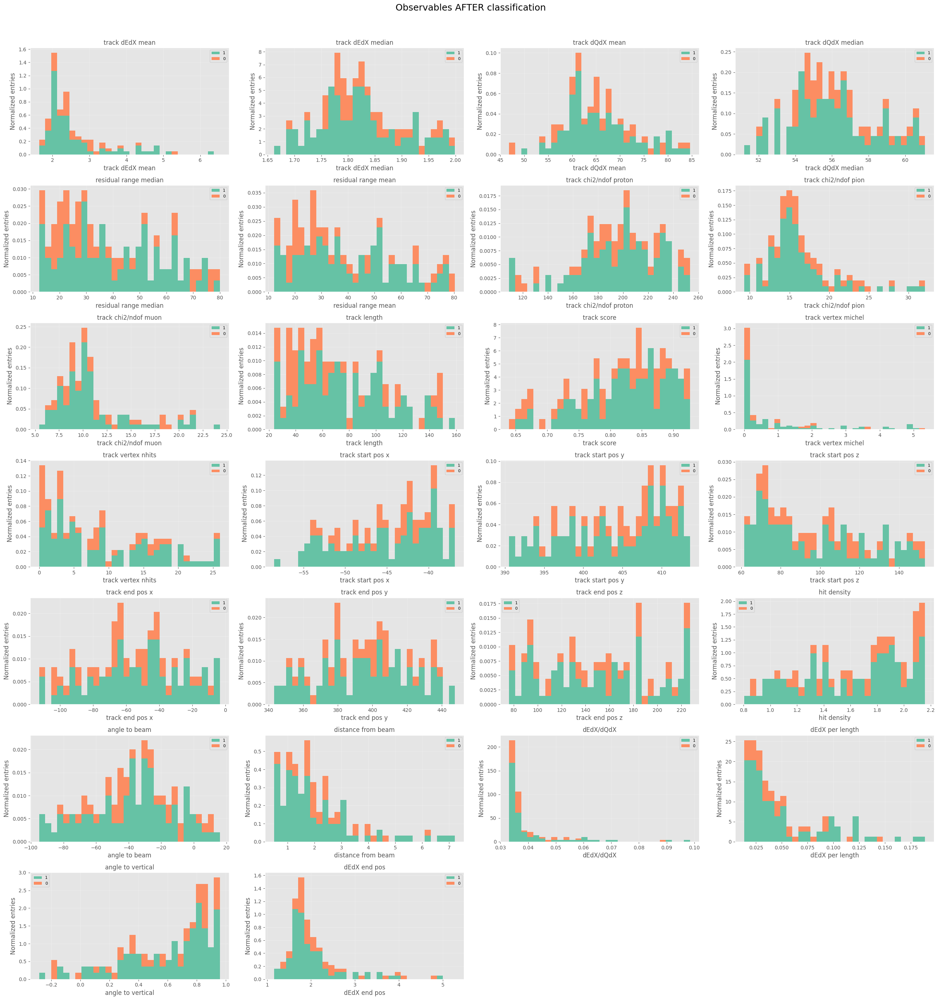

In [97]:
RF = RandomForestClassifier(n_estimators=50, max_depth=8, random_state=42, criterion="gini");
master_pion_selection(data=small_split_data_binary, model=RF, verbose=True, plot=True, title="Random Forest");

In [18]:
RF = RandomForestClassifier(n_estimators=50, max_depth=10, random_state=42, criterion="gini");
master_pion_selection(data=full_split_data, model=RF, verbose=True, plot=False, title="Random Forest");

Fitting model...
Model fitted.
           $\pi^{\pm}$     Test Data    Train Data
0       Test Particles         73558        294232
1               Purity  65.7% ± 0.4%  66.3% ± 0.2%
2           Efficiency  75.7% ± 0.4%  77.2% ± 0.2%
3  Purity x Efficiency  49.8% ± 0.7%  51.1% ± 0.4%


In [19]:
RF = RandomForestClassifier(n_estimators=50, max_depth=10, random_state=42, criterion="gini");
master_pion_selection(data=full_split_data_binary, model=RF, verbose=True, plot=False, title="Random Forest");

Fitting model...
Model fitted.
                     1     Test Data    Train Data
0       Test Particles         73558        294232
1               Purity  74.8% ± 0.4%  75.7% ± 0.2%
2           Efficiency  60.6% ± 0.4%  62.7% ± 0.2%
3  Purity x Efficiency  45.3% ± 0.8%  47.5% ± 0.4%


In [30]:
RF = RandomForestClassifier(n_estimators=50, max_depth=10, random_state=42, criterion="gini");
RF, _, _= master_pion_selection(data=full_split_data_binary_balanced, model=RF, verbose=True, plot=False, title="Random Forest");

Fitting model...
Model fitted.
                     1     Test Data    Train Data
0       Test Particles         28316        113262
1               Purity  83.6% ± 0.3%  84.9% ± 0.1%
2           Efficiency  89.7% ± 0.3%  91.6% ± 0.1%
3  Purity x Efficiency  75.0% ± 0.6%  77.8% ± 0.3%


In [32]:
get_class_performance(RF, x_train=full_x_train_binary_balanced, y_train=full_y_train_binary_balanced, x_test=full_x_test_binary, y_test=full_y_test_binary, class_label=1)

,1,Test Data,Train Data
0,Test Particles,73558,113262
1,Purity,55.0% ± 0.3%,84.9% ± 0.1%
2,Efficiency,91.1% ± 0.2%,91.6% ± 0.1%
3,Purity x Efficiency,50.1% ± 0.6%,77.8% ± 0.3%


## XGBoost

In [13]:
xgb = XGBClassifier(n_estimators=32, max_depth=10, learning_rate=0.05, random_state=42)
xgb = master_pion_selection(data=full_split_data_binary, model=xgb, verbose=True)

Fitting model...


Model fitted.
                     1     Test Data    Train Data
0       Test Particles         73558        294232
1               Purity  74.2% ± 0.4%  76.1% ± 0.2%
2           Efficiency  67.5% ± 0.4%  71.0% ± 0.2%
3  Purity x Efficiency  50.1% ± 0.8%  54.1% ± 0.4%


## MLP Classifier

In [ ]:
mlp = MLPClassifier(max_iter=1000, random_state=42, hidden_layer_sizes=(32, 32))
mlp = master_pion_selection(data=small_split_data_binary, model=mlp, verbose=True)

# DT & RF hyperparameter tuning
Iteratively testing the performance of different hyperparameters.

In [ ]:
rf_hyper_param_tuning = {
    "max_depth": np.arange(2, 16, 1),
    "n_estimators": [1, 2, 3, 5, 7, 10, 15, 20, 25, 30, 40, 50],
}

rf_fixed_hyper_params = {
    "max_depth": 7,
    "n_estimators": 30
}

hp_tuning_results = tune_hp(full_split_data, rf_hyper_param_tuning, rf_fixed_hyper_params, "rf", plot=True, save=True, verbose=True);

TUNING RANDOM FOREST HYPERPARAMETERS
--------------------------------
Testing max_depth = 2...
Fitting model...
Model fitted.
['$p$' '$p$' '$\\pi^{\\pm}$' ... '$p$' '$\\gamma$' '$\\pi^{\\pm}$']
TRAIN: Purity: 50.1%, Efficiency: 67.2%
TEST: Purity: 50.1%, Efficiency: 66.5%
--------------------------------
Testing max_depth = 3...
Fitting model...
Model fitted.
['$p$' '$p$' '$\\pi^{\\pm}$' ... '$p$' '$\\gamma$' '$\\pi^{\\pm}$']
TRAIN: Purity: 51.2%, Efficiency: 74.9%
TEST: Purity: 51.1%, Efficiency: 74.2%
--------------------------------
Testing max_depth = 4...
Fitting model...
Model fitted.
['$p$' '$p$' '$\\pi^{\\pm}$' ... '$p$' '$\\gamma$' '$\\pi^{\\pm}$']
TRAIN: Purity: 52.2%, Efficiency: 75.7%
TEST: Purity: 52.2%, Efficiency: 75.2%
--------------------------------
Testing max_depth = 5...
Fitting model...
Model fitted.
['$p$' '$p$' '$\\pi^{\\pm}$' ... '$p$' '$\\gamma$' '$\\pi^{\\pm}$']
TRAIN: Purity: 54.1%, Efficiency: 75.8%
TEST: Purity: 53.8%, Efficiency: 75.3%
-------------------

pdf /home/pemb6649/pi0-analysis/analysis/summer-placement/hp-tuning-plots/hp_results_9.pdf has been opened
pdf /home/pemb6649/pi0-analysis/analysis/summer-placement/hp-tuning-plots/hp_results_9.pdf has been closed


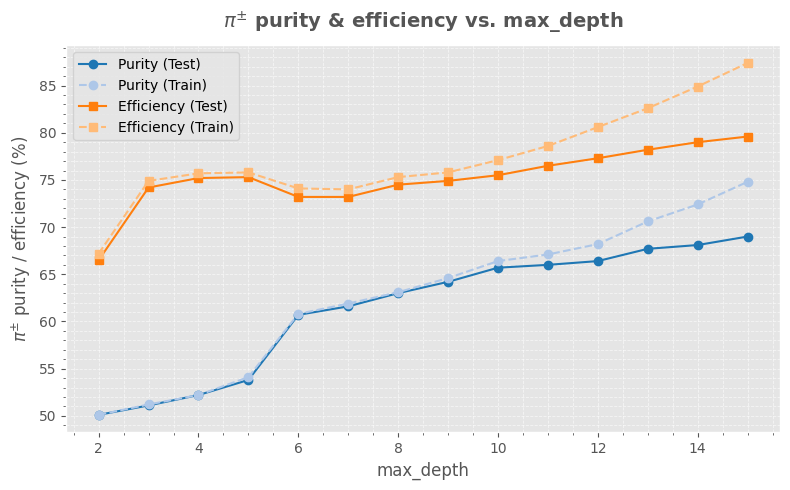

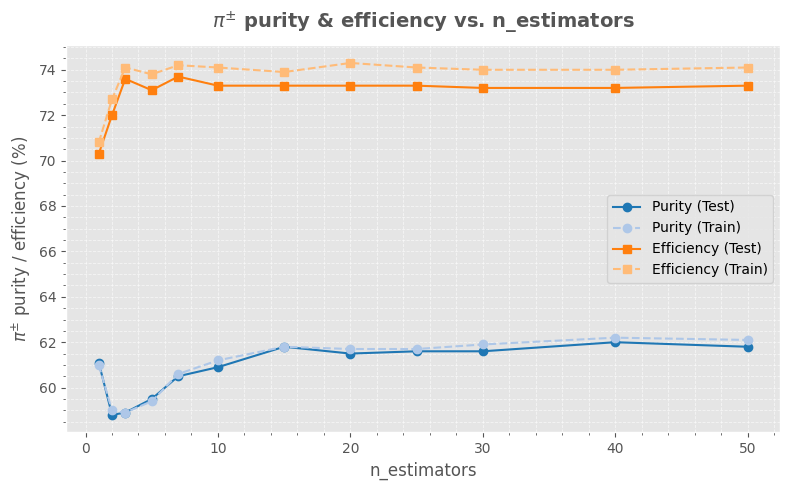

In [104]:
plot_tuning_results(hp_tuning_results, save=True)

In [8]:
rf_hyper_param_tuning = {
    "max_depth": np.arange(2, 16, 1)
}

rf_fixed_hyper_params = {
    "n_estimators": 50,
}

hp_tuning_results = tune_hp(full_split_data, rf_hyper_param_tuning, rf_fixed_hyper_params, "rf", plot=True, save=True, verbose=True);

TUNING RANDOM FOREST HYPERPARAMETERS
--------------------------------
Testing max_depth = 2...
Fitting model...
Model fitted.
TRAIN: Purity: 46.7%, Efficiency: 74.1%
TEST: Purity: 46.4%, Efficiency: 73.5%
--------------------------------
Testing max_depth = 3...
Fitting model...
Model fitted.
TRAIN: Purity: 50.2%, Efficiency: 76.7%
TEST: Purity: 50.1%, Efficiency: 76.3%
--------------------------------
Testing max_depth = 4...
Fitting model...
Model fitted.
TRAIN: Purity: 52.0%, Efficiency: 76.1%
TEST: Purity: 52.0%, Efficiency: 75.6%
--------------------------------
Testing max_depth = 5...
Fitting model...
Model fitted.
TRAIN: Purity: 55.1%, Efficiency: 75.1%
TEST: Purity: 54.8%, Efficiency: 74.3%
--------------------------------
Testing max_depth = 6...
Fitting model...
Model fitted.
TRAIN: Purity: 60.4%, Efficiency: 74.1%
TEST: Purity: 60.3%, Efficiency: 73.2%
--------------------------------
Testing max_depth = 7...
Fitting model...
Model fitted.
TRAIN: Purity: 62.1%, Efficiency: 

pdf /home/pemb6649/pi0-analysis/analysis/summer-placement/hp-tuning-plots/hp_results_18.pdf has been opened
pdf /home/pemb6649/pi0-analysis/analysis/summer-placement/hp-tuning-plots/hp_results_18.pdf has been closed


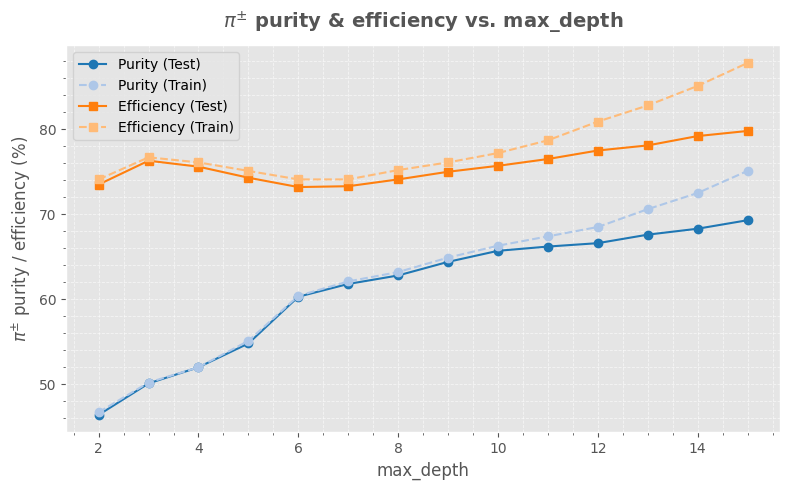

In [9]:
plot_tuning_results(hp_tuning_results, save=True)

# XGB hyperparameter tuning

In [23]:
xgb_hyper_param_tuning = {
    "n_estimators": [2, 5, 7, 10, 12, 15, 17, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75]
}

xgb_fixed_hyper_params = {
    "max_depth": 5,
    "eta": 0.2
}

hp_tuning_results = tune_hp(full_split_data, xgb_hyper_param_tuning, xgb_fixed_hyper_params, "xgb", plot=True, save=True, verbose=True);

TUNING XGBOOST HYPERPARAMETERS
--------------------------------
Testing n_estimators = 2...
Fitting model...
Model fitted.
TRAIN: Purity: 64.8%, Efficiency: 71.6%
TEST: Purity: 64.6%, Efficiency: 70.7%
--------------------------------
Testing n_estimators = 5...
Fitting model...
Model fitted.
TRAIN: Purity: 64.5%, Efficiency: 73.4%
TEST: Purity: 64.2%, Efficiency: 72.8%
--------------------------------
Testing n_estimators = 7...
Fitting model...
Model fitted.
TRAIN: Purity: 65.0%, Efficiency: 74.2%
TEST: Purity: 64.8%, Efficiency: 73.6%
--------------------------------
Testing n_estimators = 10...
Fitting model...
Model fitted.
TRAIN: Purity: 65.1%, Efficiency: 75.1%
TEST: Purity: 65.1%, Efficiency: 74.7%
--------------------------------
Testing n_estimators = 12...
Fitting model...
Model fitted.
TRAIN: Purity: 65.1%, Efficiency: 75.4%
TEST: Purity: 65.0%, Efficiency: 75.0%
--------------------------------
Testing n_estimators = 15...
Fitting model...
Model fitted.
TRAIN: Purity: 65.5

pdf /home/pemb6649/pi0-analysis/analysis/summer-placement/hp-tuning-plots/hp_results_16.pdf has been opened
pdf /home/pemb6649/pi0-analysis/analysis/summer-placement/hp-tuning-plots/hp_results_16.pdf has been closed


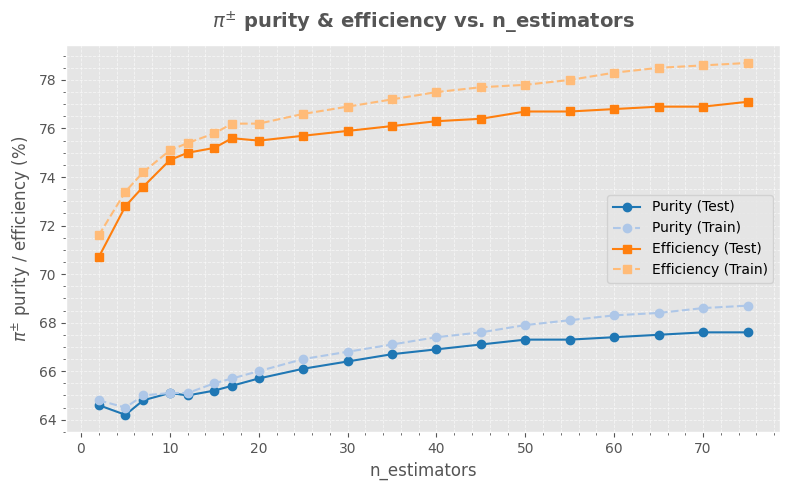

In [24]:
plot_tuning_results(hp_tuning_results, save=True)

# Observables correlation plots

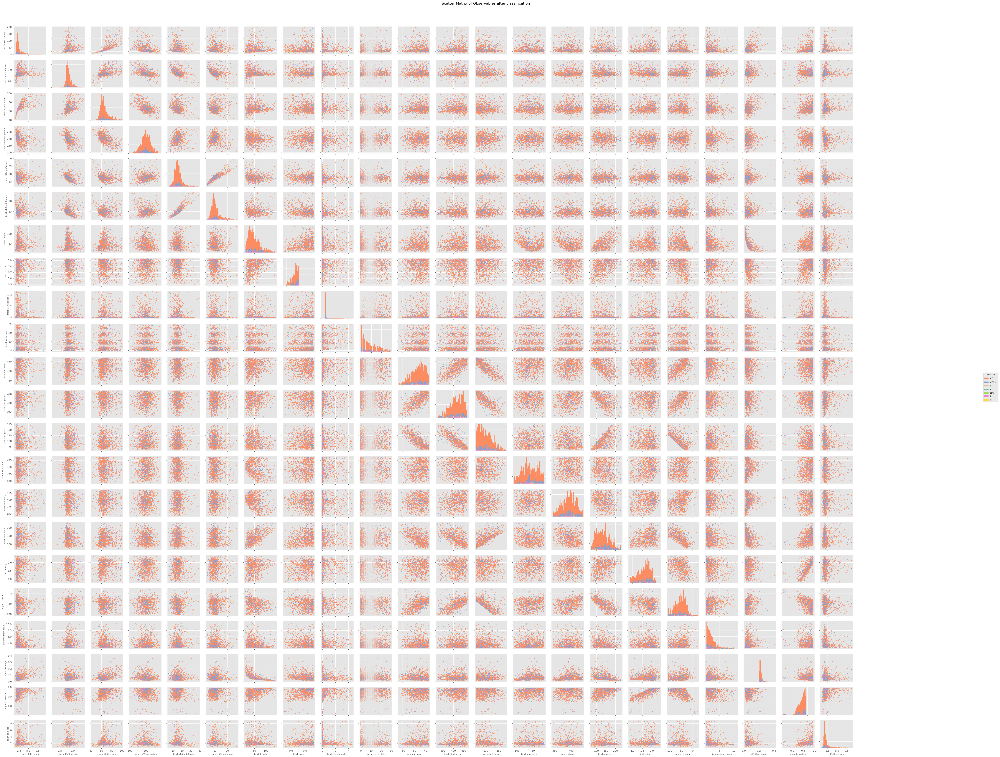

In [109]:
model = DecisionTreeClassifier(max_depth=10, random_state=42)
model.fit(full_x_train, full_y_train)
y_pred = model.predict(full_x_test).tolist()
y_test = full_y_test.tolist()

plot_scatter_matrix(get_classified_df(full_x_test, y_test, y_pred, [pion_class_label]), title="Scatter Matrix of Observables after classification", size=(50, 40))

## Test after removing correlated observables

Fitting model...


Model fitted.
           $\pi^{\pm}$     Test Data    Train Data
0       Test Particles         73558        294232
1               Purity  63.2% ± 0.4%  64.2% ± 0.2%
2           Efficiency  75.0% ± 0.4%  76.7% ± 0.2%
3  Purity x Efficiency  47.4% ± 0.7%  49.2% ± 0.4%


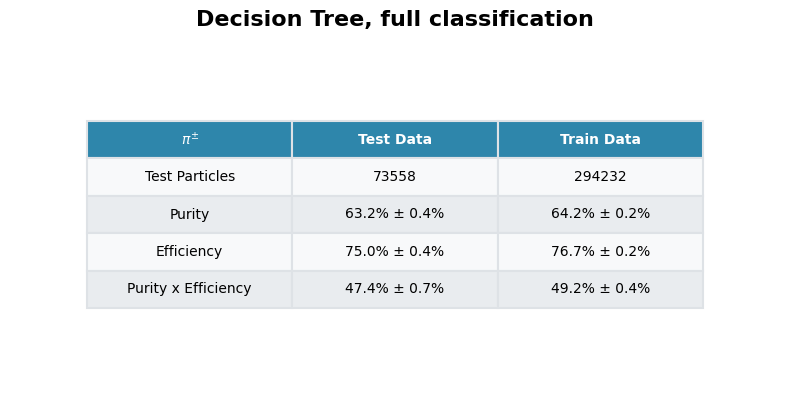

Cannot calculate standard deviation of feature importances (likely if you have used a decision tree).


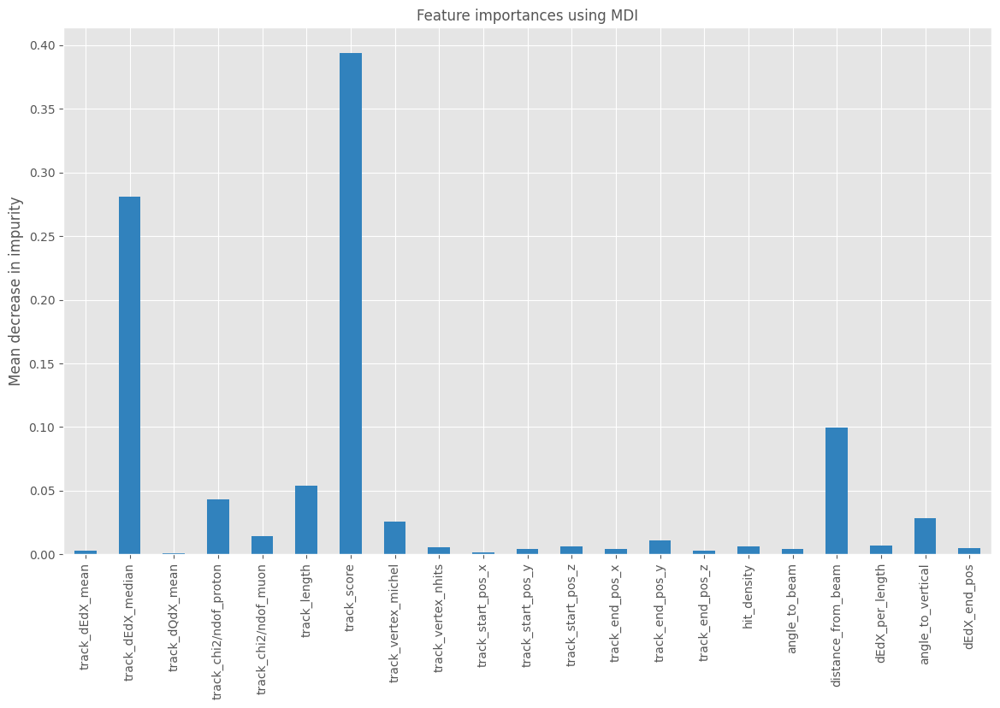

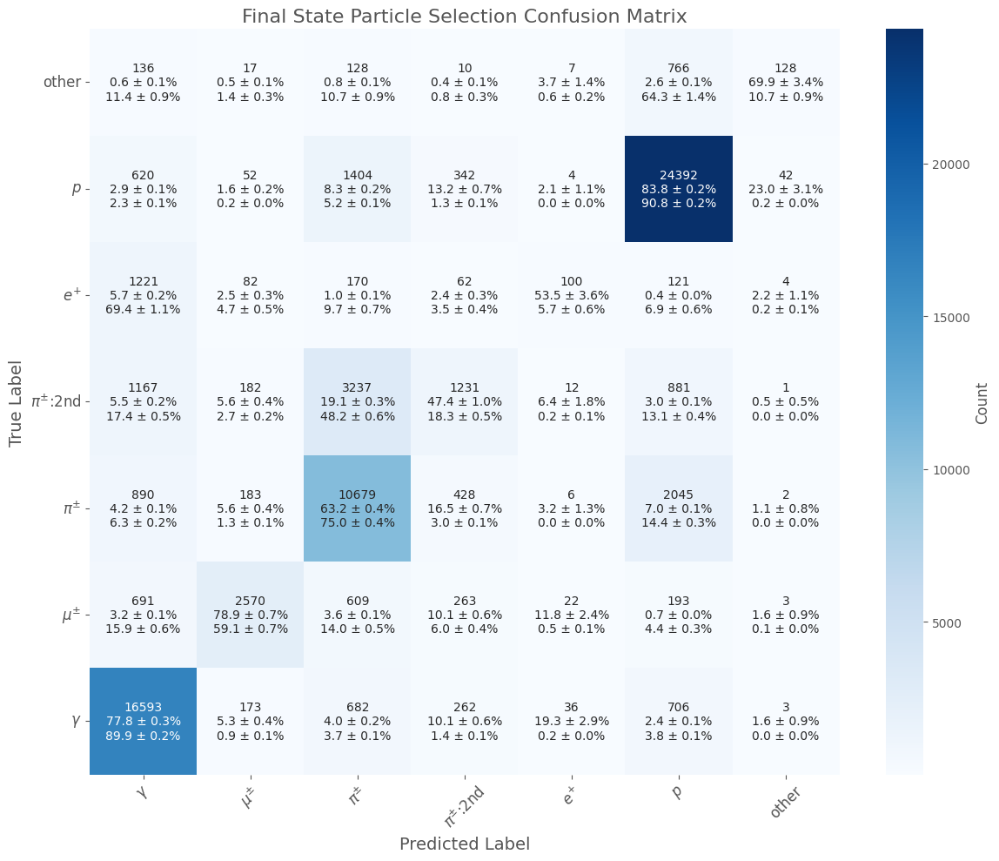

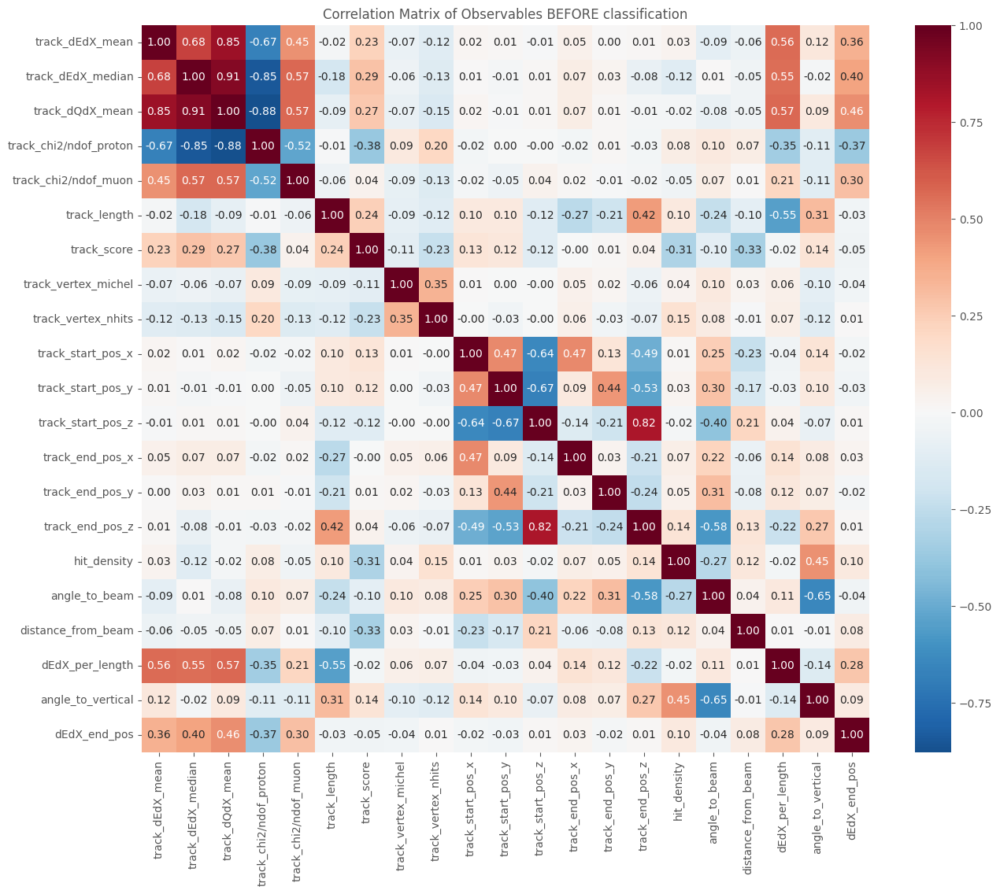

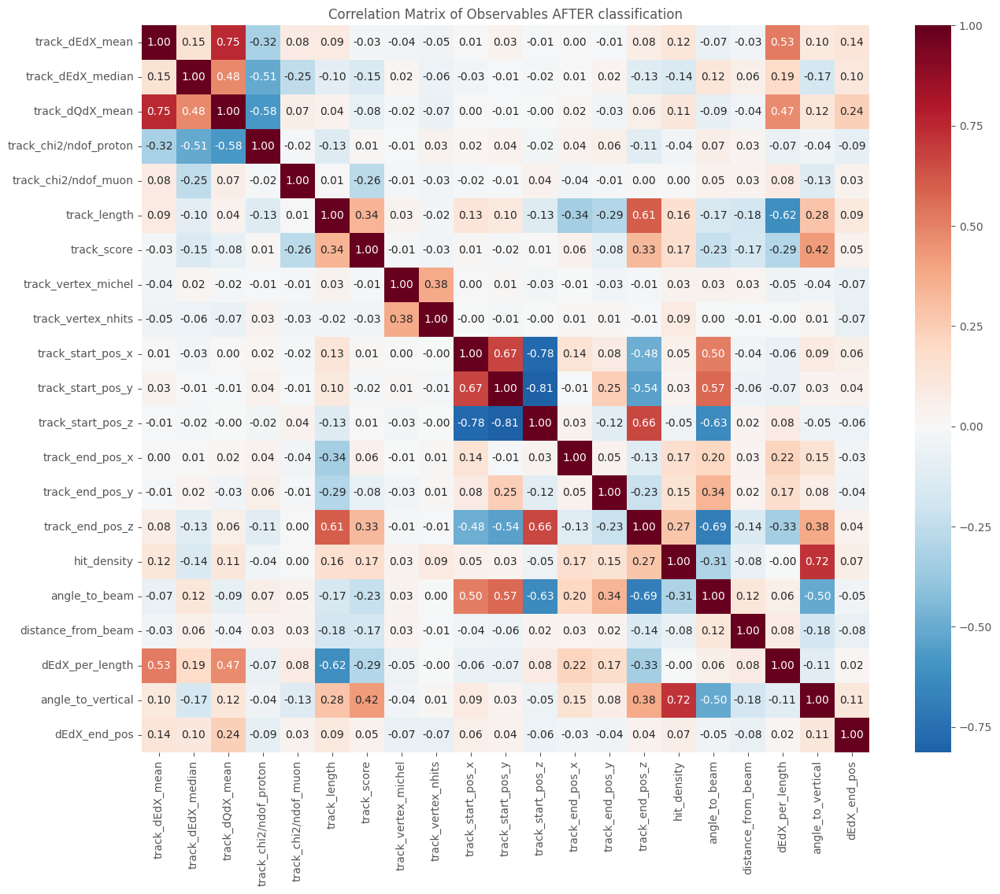

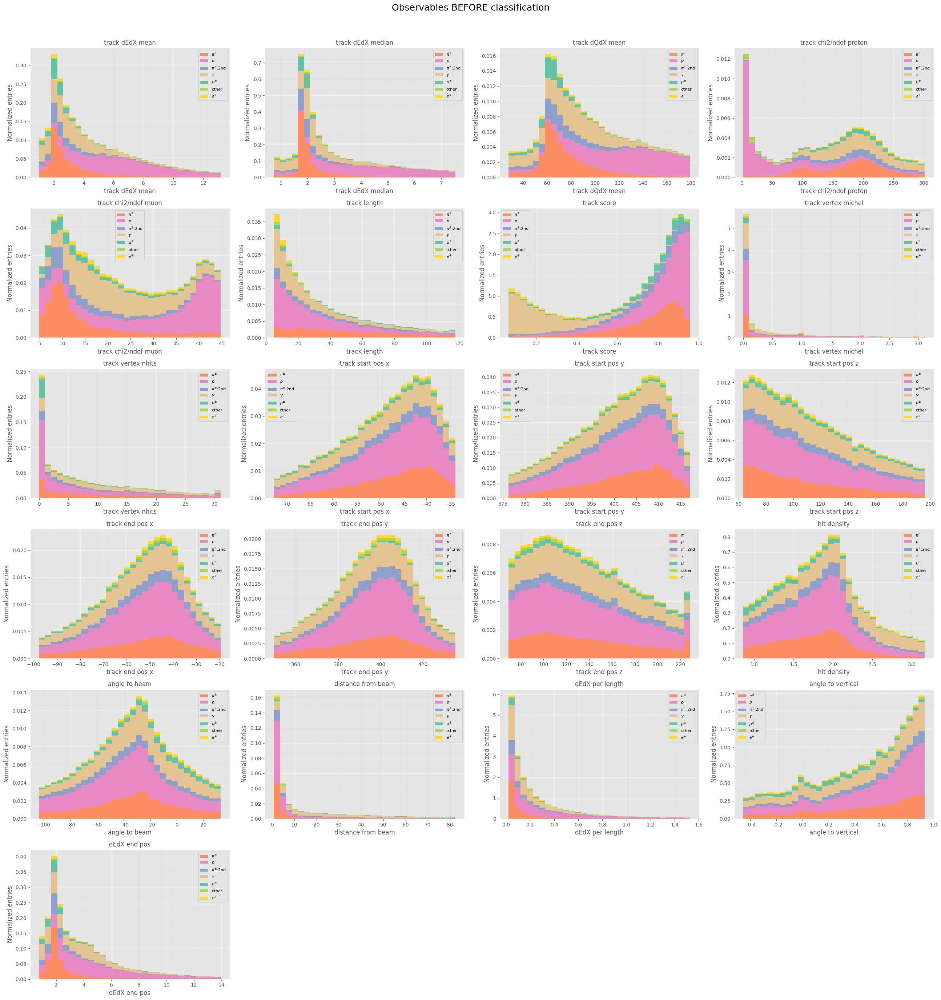

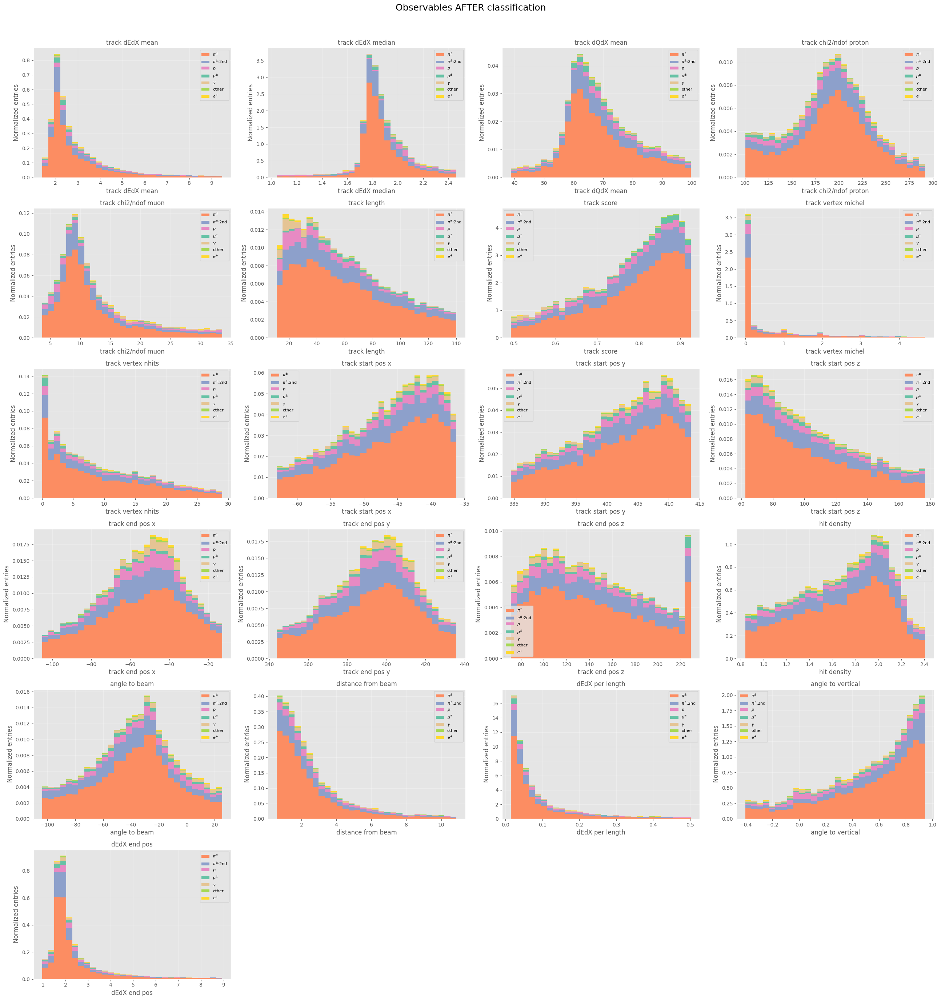

In [119]:
# let's do a quick test after removing the correlated observables
drop_cols = ["residual_range_mean", "residual_range_median", "track_chi2/ndof_pion", "track_dQdX_median", "dEdX/dQdX"]
model = DecisionTreeClassifier(max_depth=10, random_state=42)
master_pion_selection(data=full_split_data, drop_cols=drop_cols, title="Decision Tree", model=DT, plot=True, verbose=True)

# Cut-based selection

Pion purity: 51.1% ± 0.2%
Pion efficiency: 53.4% ± 0.2%


([0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  1,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  1,
  0,
  0,
  0,
  1,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  1,
  0,
  1,
  0,
  1,
  1,
  0,
  0,
  1,
  0,
  1,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  0,
  1,
  0,
  1,
  0,


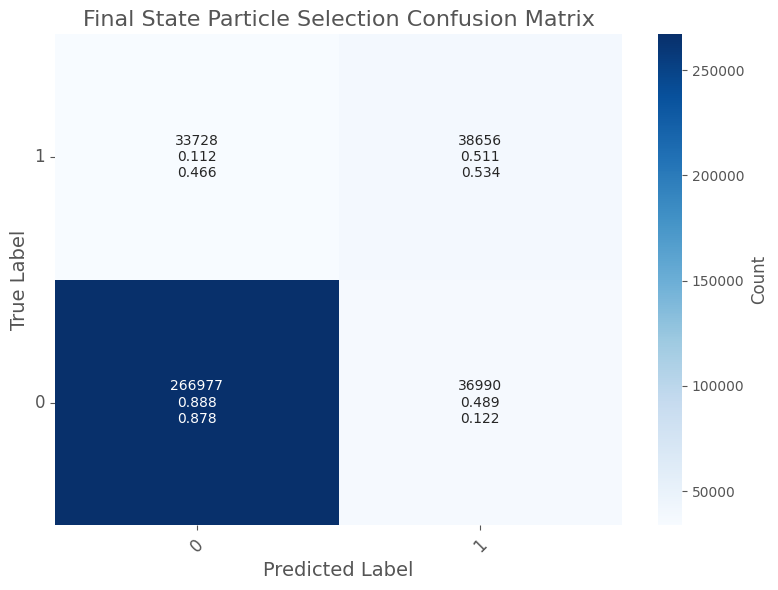

In [ ]:
cut_based_selection(mc_files, size=-1, verbose=True, plot=True);

# Adapting threshold with best performing model

In [ ]:
DT = DecisionTreeClassifier(random_state=42, 
                            criterion="gini", 
                            max_depth=5)

master_pion_selection(data=full_split_data_binary, 
                      model=DT,
                      threshold=0.7, 
                      save=False, 
                      verbose=True);

Fitting model...
Model fitted.
                     1     Test Data    Train Data
0       Test Particles         73558        294232
1               Purity  73.5% ± 0.5%  73.9% ± 0.3%
2           Efficiency  38.0% ± 0.4%  38.5% ± 0.2%
3  Purity x Efficiency  28.0% ± 0.9%  28.5% ± 0.5%


# XGB with custom loss function
My master pion function only works with scikit-learn models, whereas to specify a custom loss function requires using a lower level version of XGBoost, so we must use the functions manually.

In [37]:
import xgboost as xgb

dtrain_full = xgb.DMatrix(full_x_train, label=le.transform(full_y_train))
dtest_full = xgb.DMatrix(full_x_test, label=le.transform(full_y_test))

dtrain_binary = xgb.DMatrix(full_x_train_binary, label=full_y_train_binary)
dtest_binary = xgb.DMatrix(full_x_test_binary, label=full_y_test_binary)

dtrain_binary_balanced = xgb.DMatrix(full_x_train_binary_balanced, label=full_y_train_binary_balanced)
dtest_binary_balanced = xgb.DMatrix(full_x_test_binary_balanced, label=full_y_test_binary_balanced)

## Binary

In [38]:
params = {'max_depth': 5, 
          'eta': 0.2, 
          'seed': 42, 
          'objective': 'binary:logistic'}

model = xgb.train(
    params,
    dtrain_binary,
    num_boost_round=20,
    obj=binary_purity_loss,
)

In [55]:
get_class_performance(model, dtrain=dtrain_binary, dtest=dtest_binary, class_label=1, threshold=0.5, binary_classification=True)


,1,Test Data,Train Data
0,Test Particles,73558,294232
1,Purity,73.4% ± 0.4%,74.1% ± 0.2%
2,Efficiency,61.6% ± 0.4%,62.6% ± 0.2%
3,Purity x Efficiency,45.2% ± 0.8%,46.4% ± 0.4%


In [39]:
binary_XGB_pion_probs = model.predict(dtest_binary)

In [40]:
params = {'max_depth': 5, 
          'eta': 0.2, 
          'seed': 42, 
          'objective': 'binary:logistic'}

model = xgb.train(
    params,
    dtrain_binary_balanced,
    num_boost_round=20,
    obj=binary_purity_loss,
)

In [51]:
# log loss
get_class_performance(model, dtrain=dtrain_binary_balanced, dtest=dtest_binary_balanced, class_label=1, threshold=0.5, binary_classification=True)

,1,Test Data,Train Data
0,Test Particles,28316,113262
1,Purity,84.2% ± 0.3%,85.2% ± 0.1%
2,Efficiency,85.1% ± 0.3%,85.8% ± 0.1%
3,Purity x Efficiency,71.7% ± 0.6%,73.1% ± 0.3%


In [52]:
get_class_performance(model, dtrain=dtrain_binary_balanced, dtest=dtest_binary, class_label=1, threshold=0.5, binary_classification=True)

,1,Test Data,Train Data
0,Test Particles,73558,113262
1,Purity,56.2% ± 0.3%,85.2% ± 0.1%
2,Efficiency,85.7% ± 0.3%,85.8% ± 0.1%
3,Purity x Efficiency,48.1% ± 0.6%,73.1% ± 0.3%


In [41]:
binary_balanced_XGB_pion_probs = model.predict(dtest_binary)

## Full classification

In [42]:
params = {'max_depth': 5, 
          'eta': 0.2, 
          'seed': 42, 
          'num_class': len(np.unique(full_y_train)), 
          "objective": "multi:softprob"  # output probability for each class
          }

model = xgb.train(
    params,
    dtrain_full,
    num_boost_round=20,
    obj=multiclass_purity_loss
)

In [41]:
get_class_performance(model, le, dtrain=dtrain_full, dtest=dtest_full, class_label=pion_class_label)

,$\pi^{\pm}$,Test Data,Train Data
0,Test Particles,73558,294232
1,Purity,67.8% ± 0.4%,68.0% ± 0.2%
2,Efficiency,73.9% ± 0.4%,74.6% ± 0.2%
3,Purity x Efficiency,50.1% ± 0.7%,50.7% ± 0.4%


In [43]:
full_XGB_pion_probs = get_class_probabilities(model, le, x_test=dtest_full, class_label=pion_class_label)

# ROC Curve
Plots of true positive rate TP / (TP+FN) vs false positive rate FP / (FP + TN) for different models.

## Train and save best models

In [33]:
DT = DecisionTreeClassifier(max_depth=8, random_state=42)
DT, _ = train_model(DT, x_train=full_x_train, y_train=full_y_train, verbose=True)

DT_binary = DecisionTreeClassifier(max_depth=8, random_state=42)
DT_binary, _ = train_model(DT_binary, x_train=full_x_train_binary, y_train=full_y_train_binary, verbose=True)

DT_binary_balanced = DecisionTreeClassifier(max_depth=8, random_state=42)
DT_binary_balanced, _ = train_model(DT_binary, x_train=full_x_train_binary_balanced, y_train=full_y_train_binary_balanced, verbose=True)

RF = DecisionTreeClassifier(max_depth=10, random_state=42)
RF, _ = train_model(RF, x_train=full_x_train, y_train=full_y_train, verbose=True)

RF_binary = DecisionTreeClassifier(max_depth=10, random_state=42)
RF_binary, _ = train_model(RF_binary, x_train=full_x_train_binary, y_train=full_y_train_binary, verbose=True)

RF_binary_balanced = DecisionTreeClassifier(max_depth=10, random_state=42)
RF_binary_balanced, _ = train_model(RF_binary_balanced, x_train=full_x_train_binary_balanced, y_train=full_y_train_binary_balanced, verbose=True)

Fitting model...
Model fitted.
Fitting model...
Model fitted.
Fitting model...
Model fitted.
Fitting model...
Model fitted.
Fitting model...
Model fitted.
Fitting model...
Model fitted.


In [34]:
models = {
    "DT": DT,
    "DT_binary": DT_binary,
    "DT_binary_balanced": DT_binary_balanced,
    "RF": RF,
    "RF_binary": RF_binary,
    "RF_binary_balanced": RF_binary_balanced
}

save_file(models, "/home/pemb6649/pi0-analysis/analysis/summer-placement/models/all_sklearn_models_full_dataset.pkl")

Saved {'DT': DecisionTreeClassifier(max_depth=8, random_state=42), 'DT_binary': DecisionTreeClassifier(max_depth=8, random_state=42), 'DT_binary_balanced': DecisionTreeClassifier(max_depth=8, random_state=42), 'RF': DecisionTreeClassifier(max_depth=10, random_state=42), 'RF_binary': DecisionTreeClassifier(max_depth=10, random_state=42), 'RF_binary_balanced': DecisionTreeClassifier(max_depth=10, random_state=42)} to /home/pemb6649/pi0-analysis/analysis/summer-placement/models/all_sklearn_models_full_dataset.pkl


## Get probabilities

In [35]:
models = load_file("/home/pemb6649/pi0-analysis/analysis/summer-placement/models/all_sklearn_models_full_dataset.pkl")

In [36]:
DT_pion_probs = get_class_probabilities(models["DT"], x_test=full_x_test, le=le, class_label=pion_class_label)
binary_DT_pion_probs = get_class_probabilities(models["DT_binary"], x_test=full_x_test_binary, class_label=1)
balanced_binary_DT_pion_probs = get_class_probabilities(models["DT_binary_balanced"], x_test=full_x_test_binary, class_label=1)
RF_pion_probs = get_class_probabilities(models["RF"], x_test=full_x_test, le=le, class_label=pion_class_label)
binary_RF_pion_probs = get_class_probabilities(models["RF_binary"], x_test=full_x_test_binary, class_label=1)
balanced_binary_RF_pion_probs = get_class_probabilities(models["RF_binary_balanced"], x_test=full_x_test_binary, class_label=1)

In [44]:
model_probs = {
    "DT_full": DT_pion_probs,
    "DT_binary_unbalanced": binary_DT_pion_probs,
    "DT_binary_balanaced": balanced_binary_DT_pion_probs,
    "RF_full": RF_pion_probs,
    "RF_binary_unbalanced": binary_RF_pion_probs,
    "RF_binary_balanced": balanced_binary_RF_pion_probs,
    "XGB_full": full_XGB_pion_probs,
    "XGB_binary_unbalanced": binary_XGB_pion_probs,
    "XGB_binary_balanced": binary_balanced_XGB_pion_probs
}

In [45]:
save_file(model_probs, "/home/pemb6649/pi0-analysis/analysis/summer-placement/models/model_pion_probs.pkl")

Saved {'DT_full': array([0.33399015, 0.01818182, 0.76026255, ..., 0.03266004, 0.12034799,
       0.76026255]), 'DT_binary_unbalanced': array([0.63690923, 0.01624431, 0.9224437 , ..., 0.05442177, 0.3045977 ,
       0.9224437 ]), 'DT_binary_balanaced': array([0.63690923, 0.01624431, 0.9224437 , ..., 0.05442177, 0.3045977 ,
       0.9224437 ]), 'RF_full': array([0.0625    , 0.00746269, 0.73040636, ..., 0.02155836, 0.1322208 ,
       0.81320225]), 'RF_binary_unbalanced': array([0.0486618 , 0.00698925, 0.71140027, ..., 0.02056075, 0.10518135,
       0.71033654]), 'RF_binary_balanced': array([0.63273453, 0.01435095, 0.9315832 , ..., 0.        , 0.30970149,
       0.9315832 ]), 'XGB_full': array([0.16441064, 0.00818126, 0.6656716 , ..., 0.02597035, 0.09691538,
       0.82673174], dtype=float32), 'XGB_binary_unbalanced': array([0.38716206, 0.3268057 , 0.5404056 , ..., 0.32156014, 0.3568482 ,
       0.6231892 ], dtype=float32), 'XGB_binary_balanced': array([0.5198614 , 0.34020582, 0.5789605 , .

Pion purity: 51.1% ± 0.2%
Pion efficiency: 53.4% ± 0.2%


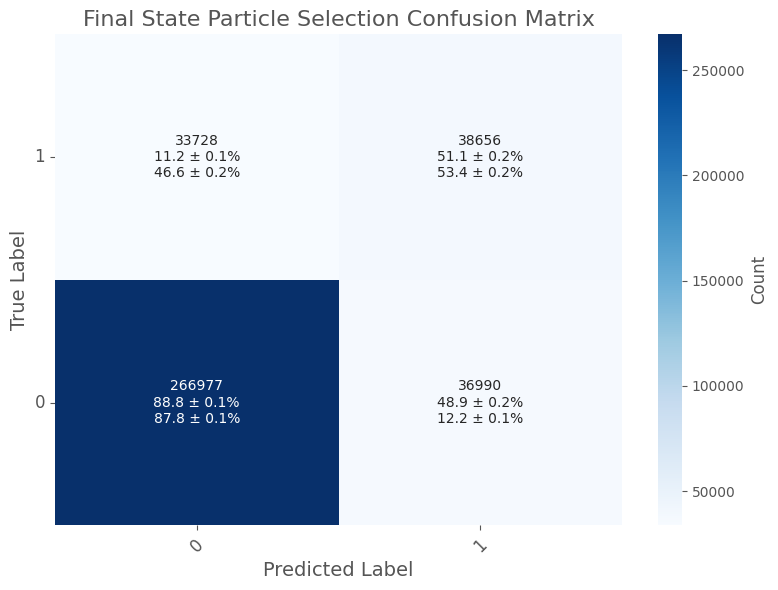

In [46]:
y_test_cut, y_pred_cut = cut_based_selection(mc_files, size=-1, verbose=True, plot=True)

# boot strap approach to get mean and std for cut-based fpr and tpr
cut_stats = get_cut_based_roc_point_with_errors(y_test_cut, y_pred_cut)

## Plot ROC curve

pdf /home/pemb6649/pi0-analysis/analysis/summer-placement/roc-curve.pdf has been opened
pdf /home/pemb6649/pi0-analysis/analysis/summer-placement/roc-curve.pdf has been closed


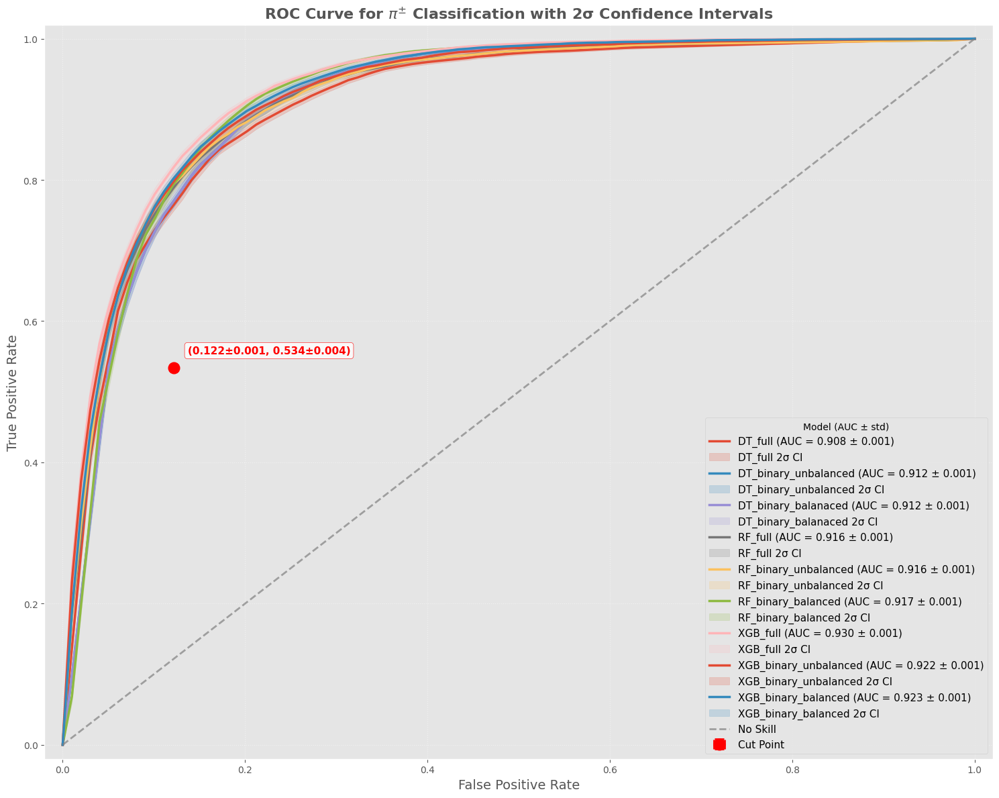

In [47]:
filepath = "/home/pemb6649/pi0-analysis/analysis/summer-placement/roc-curve"
book = Plots.PlotBook(filepath)
plot_roc_curve(np.array(list(full_y_test_binary)), model_probs, pion_class_label, cut_stats=cut_stats, sigma_interval=2)
book.Save()
book.close()

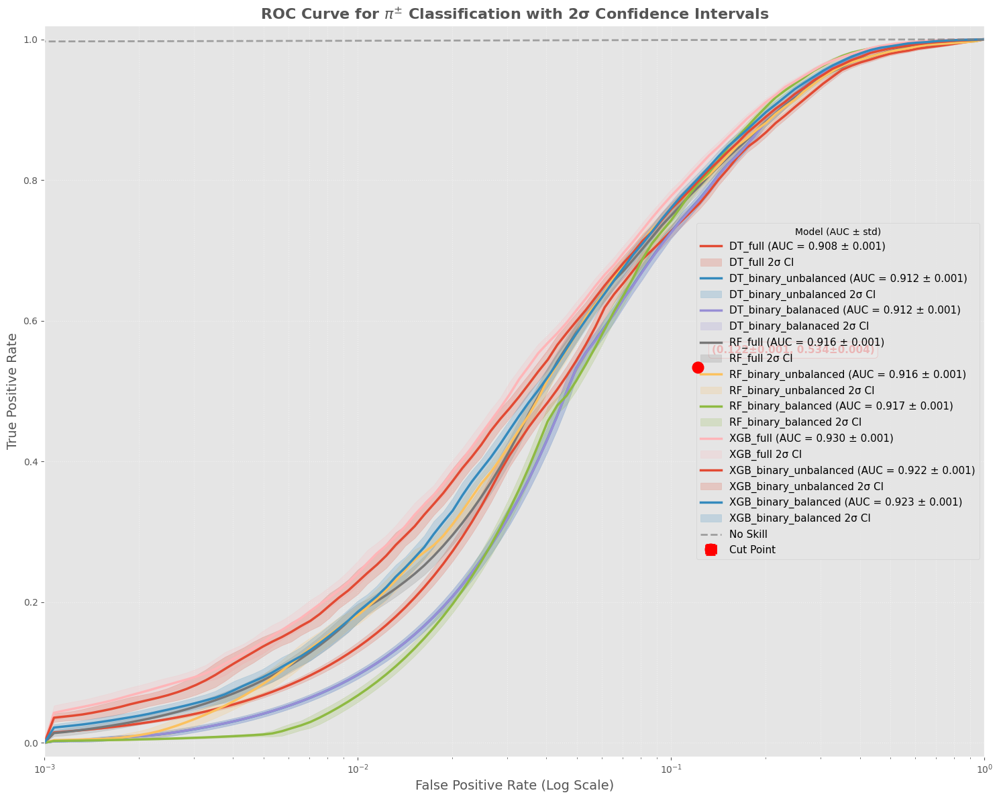

In [48]:
plot_roc_curve(np.array(list(full_y_test_binary)), model_probs, pion_class_label, cut_stats=cut_stats, sigma_interval=2, log=True)